<a href="https://colab.research.google.com/github/CA683-Group99/Wind-Energy-Prediction/blob/main/SharedIslandElectricityData_ver2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import io
import requests


from plotly.offline import iplot
import plotly.graph_objs as go
from plotly import tools
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

from datetime import tzinfo, timedelta, datetime, date

# Any results you write to the current directory are saved as output.

import plotly.express as px
import seaborn as sns

## General settings

In [2]:
usePreloadedData = True # True to load pre-prepared dataset , False to load directly from eirgrid data

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import os
os.chdir('/content/drive/MyDrive/CA683Project')


# V2 Changes

- Load whole of Island data Region=ALL - as Republic of Ireland and Nortern Ireland work as 1 electricity market.

- Rename for convenience: 

  newdf = newdf.rename(columns={' FORECAST WIND(MW)' : 'ForecastWndMW'})

  newdf = newdf.rename(columns={' ACTUAL GENERATION(MW)' : 'ActualGenerationMW'})


  ## Add Interconnections with Great Britain (only international connections for now) from Eirgrid site
{' NET TOTAL(MW)': 'NetTotal_MW'})
{' EWIC(MW)': 'EWIC_MW'})
{' MOYLE(MW)': 'MOYLE_MW'})

The Interconnection flows displayed above represent the estimated current net electricity transfer in MW on the East West and Moyle Interconnectors; as measured at Deeside, Wales (EWIC) and Auchencrosh, Scotland (Moyle).

The East West Interconnector (EWIC) connects Ireland and Wales, between Deeside in North Wales and Woodland, Co. Meath in Ireland. Approximately 260km in length, the underground and undersea link has the capacity to transport 500 Mega Watts (MW) -enough energy to power 300,000 homes.

The Moyle Interconnector links the electricity grids of Northern Ireland and Scotland through submarine cables running between converter stations at Ballycronan More in Islandmagee, Co. Antrim and Auchencrosh in Ayrshire, Scotland. The link has a capacity of 500MW.


# Eirgrid Wind generation
http://smartgriddashboard.eirgrid.com/#all

In [5]:
if usePreloadedData == False:
  # Wind energy Actual and Prediction
  
  sample_url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Jan-2018%2000:00&dateto=31-Jan-2018%2023:59'

  url_base = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-'
  url_mid = '%2000:00&dateto='
  url_end = '%2023:59'

  years = ['2017', '2018', '2019', '2020', '2021']
  months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
  endDay= [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
  tempds = []
  months_years = []

  for year in years:
    i = 0
    for month in months:
      # Stop after Feb 2021
      if (year == '2021') & (month == 'Mar'):
        break

      url = url_base + month + '-' + year + url_mid + str(endDay[i]) + '-' + month + '-' + year + url_end
      i = i+1
      print(url)
      s = requests.get(url).content

      mds = pd.read_csv(io.StringIO(s.decode('utf-8')), na_values='-')
      mds['date'] = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore')
      DT = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore').dt
      mds['Year'] = DT.year
      mds['Month'] = DT.strftime('%b')
      mds['DayTime'] = DT.strftime('%d, %R')
      tempds.append(mds)
      months_years.append(month + '-' + year)
      #url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Dec-2020%2000:00&dateto=31-Dec-2020%2023:59'


  wgds = pd.concat(tempds, keys=months_years)
  
  wgds = wgds.reset_index()
  wgds = wgds.drop('level_0', axis=1)
  wgds = wgds.drop('level_1', axis=1)
  wgds = wgds.drop('DATE & TIME', axis=1)


http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Jan-2017%2000:00&dateto=31-Jan-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Feb-2017%2000:00&dateto=28-Feb-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Mar-2017%2000:00&dateto=31-Mar-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Apr-2017%2000:00&dateto=30-Apr-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-May-2017%2000:00&dateto=31-May-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Jun-2017%2000:00&dateto=30-Jun-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Jul-2017%2000:00&datet

# Eirgrid Actual System Generation

In [6]:
if usePreloadedData == False:
  # Wind energy Actual and Prediction
  sample_url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=23-Jan-2021%2000:00&dateto=21-Feb-2021%2001:15'

  url_base = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-'

  tempds = []
  months_years = []

  for year in years:
    i = 0
    for month in months:
      # Stop after Feb 2021
      if (year == '2021') & (month == 'Mar'):
        break
      url = url_base + month + '-' + year + url_mid + str(endDay[i]) + '-' + month + '-' + year + url_end
      i = i+1
      print(url)
      s = requests.get(url).content

      mds = pd.read_csv(io.StringIO(s.decode('utf-8')), na_values='-')
      mds['date'] = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore')
      DT = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore').dt
      mds['Year'] = DT.year
      mds['Month'] = DT.strftime('%b')
      mds['DayTime'] = DT.strftime('%d, %R')
      tempds.append(mds)
      months_years.append(month + '-' + year)
      #url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=windActual&region=ALL&datefrom=01-Dec-2020%2000:00&dateto=31-Dec-2020%2023:59'


  sgds = pd.concat(tempds, keys=months_years)
  
  sgds = sgds.reset_index()
  sgds = sgds.drop('level_0', axis=1)
  sgds = sgds.drop('level_1', axis=1)
  sgds = sgds.drop('DATE & TIME', axis=1)

http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-Jan-2017%2000:00&dateto=31-Jan-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-Feb-2017%2000:00&dateto=28-Feb-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-Mar-2017%2000:00&dateto=31-Mar-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-Apr-2017%2000:00&dateto=30-Apr-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-May-2017%2000:00&dateto=31-May-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&region=ALL&datefrom=01-Jun-2017%2000:00&dateto=30-Jun-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=generationActual&reg

# System Demand: Actual and Prediction

### Data description
* **System Demand** - represents the predicted electricity production required to meet national consumption.
* **Sdate** - 
* **SREGION** - 
* **SActualDemandMW** - 
* **SFORECAST DEMAND(MW)** - 
* **SFORECAST WIND(MW)** - 
* **SActualWindMW** - 
* **Shour** - 
* **Sisweekday** - 
* **Smonth** - 
  
Actual and forecast System Demand are shown in **15 minute intervals.**

The data came from EirGrid Group about all island power systems and has been prepared by us for further analysis.

Source: https://smartgriddashboard.eirgrid.com/#all/demand

In [7]:
if usePreloadedData == False:
  # Demand Actual and Prediction
  sample_url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=18-Jan-2021%2000:00&dateto=16-Feb-2021%2023:59'
  url_base = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-'

  i = 0
  tempds = []

  for year in years:
    i = 0
    for month in months:
      # Stop after Feb 2021
      if (year == '2021') & (month == 'Mar'):
        break    
      url = url_base + month + '-' + year + url_mid + str(endDay[i]) + '-' + month + '-' + year + url_end
      i = i+1
      print(url)
      s = requests.get(url).content

      mds = pd.read_csv(io.StringIO(s.decode('utf-8')), na_values='-')
      mds['date'] = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore')
      DT = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore').dt
      mds['Year'] = DT.year
      mds['Month'] = DT.strftime('%b')
      mds['DayTime'] = DT.strftime('%d, %R')
      tempds.append(mds)

  sdds = pd.concat(tempds, keys=months_years)
  sdds = sdds.reset_index()
  sdds = sdds.drop('level_0', axis=1)
  sdds = sdds.drop('level_1', axis=1)
  sdds = sdds.drop('DATE & TIME', axis=1)


http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Jan-2017%2000:00&dateto=31-Jan-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Feb-2017%2000:00&dateto=28-Feb-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Mar-2017%2000:00&dateto=31-Mar-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Apr-2017%2000:00&dateto=30-Apr-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-May-2017%2000:00&dateto=31-May-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Jun-2017%2000:00&dateto=30-Jun-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=demandActual&region=ALL&datefrom=01-Jul-2017

In [8]:
sdds

,ACTUAL DEMAND(MW),FORECAST DEMAND(MW),REGION,date,Year,Month,DayTime
0,3696.0,NaN,All Island,2017-01-01 00:00:00,2017,Jan,"01, 00:00"
1,3661.0,NaN,All Island,2017-01-01 00:15:00,2017,Jan,"01, 00:15"
2,3622.0,NaN,All Island,2017-01-01 00:30:00,2017,Jan,"01, 00:30"
3,3492.0,NaN,All Island,2017-01-01 00:45:00,2017,Jan,"01, 00:45"
4,3457.0,NaN,All Island,2017-01-01 01:00:00,2017,Jan,"01, 01:00"
...,...,...,...,...,...,...,...
145819,4003.0,NaN,All Island,2021-02-28 22:45:00,2021,Feb,"28, 22:45"
145820,3968.0,NaN,All Island,2021-02-28 23:00:00,2021,Feb,"28, 23:00"
145821,3954.0,NaN,All Island,2021-02-28 23:15:00,2021,Feb,"28, 23:15"
145822,3888.0,NaN,All Island,2021-02-28 23:30:00,2021,Feb,"28, 23:30"


# Eirgrid Interconnections

The Interconnection flows displayed above represent the estimated current net electricity transfer in MW on the East West and Moyle Interconnectors; as measured at Deeside, Wales (EWIC) and Auchencrosh, Scotland (Moyle).

The East West Interconnector (EWIC) connects Ireland and Wales, between Deeside in North Wales and Woodland, Co. Meath in Ireland. Approximately 260km in length, the underground and undersea link has the capacity to transport 500 Mega Watts (MW) -enough energy to power 300,000 homes.

The Moyle Interconnector links the electricity grids of Northern Ireland and Scotland through submarine cables running between converter stations at Ballycronan More in Islandmagee, Co. Antrim and Auchencrosh in Ayrshire, Scotland. The link has a capacity of 500MW.


In [9]:


if usePreloadedData == False:
  # Interconnections Actual and Prediction
  sample_url = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=27-Jan-2021%2000:00&dateto=25-Feb-2021%2022:00'
  url_base = 'http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-'

  url_mid = '%2000:00&dateto='
  url_end = '%2023:59'

  tempds = []
  months_years = []

  i = 0
  tempds = []

  for year in years:
    i = 0
    for month in months:
      # Stop after Feb 2021
      if (year == '2021') & (month == 'Mar'):
        break      
      url = url_base + month + '-' + year + url_mid + str(endDay[i]) + '-' + month + '-' + year + url_end
      i = i+1
      print(url)
      s = requests.get(url).content

      mds = pd.read_csv(io.StringIO(s.decode('utf-8')), na_values='-')
      mds['date'] = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore')
      DT = pd.to_datetime(mds["DATE & TIME"], infer_datetime_format=True, errors='ignore').dt
      mds['Year'] = DT.year
      mds['Month'] = DT.strftime('%b')
      mds['DayTime'] = DT.strftime('%d, %R')
      tempds.append(mds)
      months_years.append(month + '-' + year)

  icds = pd.concat(tempds, keys=months_years)
  icds = icds.reset_index()
  icds = icds.drop('level_0', axis=1)
  icds = icds.drop('level_1', axis=1)
  icds = icds.drop('DATE & TIME', axis=1)

  icds.tail()


http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-Jan-2017%2000:00&dateto=31-Jan-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-Feb-2017%2000:00&dateto=28-Feb-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-Mar-2017%2000:00&dateto=31-Mar-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-Apr-2017%2000:00&dateto=30-Apr-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-May-2017%2000:00&dateto=31-May-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL&datefrom=01-Jun-2017%2000:00&dateto=30-Jun-2017%2023:59
http://smartgriddashboard.eirgrid.com/DashboardService.svc/csv?area=interconnection&region=ALL

In [10]:
icds

,NET TOTAL(MW),EWIC(MW),MOYLE(MW),date,Year,Month,DayTime
0,-448.0,-170.0,-278.0,2017-01-01 00:00:00,2017,Jan,"01, 00:00"
1,-541.0,-244.0,-297.0,2017-01-01 00:15:00,2017,Jan,"01, 00:15"
2,-583.0,-286.0,-297.0,2017-01-01 00:30:00,2017,Jan,"01, 00:30"
3,-585.0,-287.0,-298.0,2017-01-01 00:45:00,2017,Jan,"01, 00:45"
4,-584.0,-287.0,-297.0,2017-01-01 01:00:00,2017,Jan,"01, 01:00"
...,...,...,...,...,...,...,...
145819,320.0,0.0,320.0,2021-02-28 22:45:00,2021,Feb,"28, 22:45"
145820,302.0,0.0,302.0,2021-02-28 23:00:00,2021,Feb,"28, 23:00"
145821,447.0,74.0,373.0,2021-02-28 23:15:00,2021,Feb,"28, 23:15"
145822,595.0,149.0,446.0,2021-02-28 23:30:00,2021,Feb,"28, 23:30"


# Merge CSV to have all data based on Date and Region: All Island

In [11]:
if usePreloadedData == False:
  left = sdds.set_index(['date', 'Year', 'Month', 'DayTime', ' REGION'])
  middle = wgds.set_index(['date', 'Year', 'Month', 'DayTime', ' REGION'])
  right = sgds.set_index(['date', 'Year', 'Month', 'DayTime', ' REGION'])
  #right.index = right.index.tz_convert(None)

  newdf = left.join(middle)
  newdf = newdf.join(right)
  newdf = newdf.reset_index()
  newdf["hour"] = 0
  newdf["isweekday"] = False
  newdf["month"] = 0

  def settimeatt(row):
      row["hour"] = row.date.hour
      row["isweekday"] = (row.date.isoweekday() < 6) 
      row["month"] = row.date.month
      return row
  newdf = newdf.apply(settimeatt, axis='columns')

  newdf = newdf.rename(columns={' ACTUAL DEMAND(MW)' : 'ActualDemandMW'})
  newdf = newdf.rename(columns={'  ACTUAL WIND(MW)' : 'ActualWindMW'})

  newdf = newdf.rename(columns={' FORECAST WIND(MW)' : 'ForecastWndMW'})
  newdf = newdf.rename(columns={' ACTUAL GENERATION(MW)' : 'ActualGenerationMW'})


  # Region doesn't apply to Interconnections
  left = newdf.set_index(['date', 'Year', 'Month', 'DayTime'])
  right = icds.set_index(['date', 'Year', 'Month', 'DayTime'])
  newdf = left.join(right)
  newdf = newdf.reset_index()

  newdf = newdf.rename(columns={' NET TOTAL(MW)': 'NetTotal_MW'})
  newdf = newdf.rename(columns={' EWIC(MW)': 'EWIC_MW'})
  newdf = newdf.rename(columns={' MOYLE(MW)': 'MOYLE_MW'})

  newdf.to_csv("IslandElectricity2017_2020v3.csv") 
else:
  fileP = 'IslandElectricity2017_2020v3.csv'
  newdf = pd.read_csv(fileP)
  
newdf.head()

,date,Year,Month,DayTime,REGION,ActualDemandMW,FORECAST DEMAND(MW),ForecastWndMW,ActualWindMW,ActualGenerationMW,hour,isweekday,month,NetTotal_MW,EWIC_MW,MOYLE_MW
0,2017-01-01 00:00:00,2017,Jan,"01, 00:00",All Island,3696.0,NaN,1172.0,1214.0,4126.0,0,False,1,-448.0,-170.0,-278.0
1,2017-01-01 00:15:00,2017,Jan,"01, 00:15",All Island,3661.0,NaN,1198.0,1168.0,4184.0,0,False,1,-541.0,-244.0,-297.0
2,2017-01-01 00:30:00,2017,Jan,"01, 00:30",All Island,3622.0,NaN,1224.0,1131.0,4187.0,0,False,1,-583.0,-286.0,-297.0
3,2017-01-01 00:45:00,2017,Jan,"01, 00:45",All Island,3492.0,NaN,1250.0,1025.0,4059.0,0,False,1,-585.0,-287.0,-298.0
4,2017-01-01 01:00:00,2017,Jan,"01, 01:00",All Island,3457.0,NaN,1280.0,1123.0,4094.0,1,False,1,-584.0,-287.0,-297.0


In [12]:
newdf.columns

Index(['date', 'Year', 'Month', 'DayTime', ' REGION', 'ActualDemandMW',
       ' FORECAST DEMAND(MW)', 'ForecastWndMW', 'ActualWindMW',
       'ActualGenerationMW', 'hour', 'isweekday', 'month', 'NetTotal_MW',
       'EWIC_MW', 'MOYLE_MW'],
      dtype='object')

In [13]:
newdf.describe()

,Year,ActualDemandMW,FORECAST DEMAND(MW),ForecastWndMW,ActualWindMW,ActualGenerationMW,hour,month,NetTotal_MW,EWIC_MW,MOYLE_MW
count,145840.000000,145774.000000,0.0,145824.000000,145774.000000,145774.000000,145840.000000,145840.000000,145774.000000,145772.000000,145774.000000
mean,2018.597093,4202.416233,NaN,1361.042119,1334.557836,4253.868056,11.498848,6.330225,-21.574684,-68.185831,46.610212
std,1.197818,847.529093,NaN,1065.740697,970.950068,735.111776,6.922704,3.519724,514.605951,305.923711,245.652761
min,2017.000000,2396.000000,NaN,10.000000,-59.000000,1925.000000,0.000000,1.000000,-908.000000,-501.000000,-408.000000
25%,2018.000000,3477.000000,NaN,460.000000,483.000000,3765.000000,5.000000,3.000000,-490.000000,-331.000000,-150.000000
50%,2019.000000,4259.000000,NaN,1101.000000,1151.000000,4190.000000,11.000000,6.000000,-80.000000,0.000000,-15.000000
75%,2020.000000,4816.000000,NaN,2050.000000,2075.000000,4703.000000,17.000000,9.000000,366.000000,80.000000,258.000000
max,2021.000000,6904.000000,NaN,4980.000000,4471.000000,7501.000000,23.000000,12.000000,981.000000,579.000000,451.000000


In [14]:
#Krystian: Checking how many months do we have in our dataset (if the year is complete)
newdf.month.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

In [15]:
#Krystian: Looking for maximal extreme values
print('-----------DATA SIZE -------------')
print(newdf.shape)           # 10 Columns, 35044 rows
count_row = newdf.shape[0]   # 10 Columns
count_col = newdf.shape[1]   # 35044 rows
print('Rows: ', count_row, ', Columns: ', count_col)

print('-----------DATA INFO -------------')
print(newdf.info())

print('-----------DATA MAX Values -------------')
newdf.max()

print('-----------DATA COLUMNS-------------')
columns = newdf.columns.values.tolist()
print (columns)

print('-----------BASIC STATISTICS-------------')
newdf.tail()

-----------DATA SIZE -------------
(145840, 16)
Rows:  145840 , Columns:  16
-----------DATA INFO -------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145840 entries, 0 to 145839
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   date                  145840 non-null  datetime64[ns]
 1   Year                  145840 non-null  int64         
 2   Month                 145840 non-null  object        
 3   DayTime               145840 non-null  object        
 4    REGION               145840 non-null  object        
 5   ActualDemandMW        145774 non-null  float64       
 6    FORECAST DEMAND(MW)  0 non-null       float64       
 7   ForecastWndMW         145824 non-null  float64       
 8   ActualWindMW          145774 non-null  float64       
 9   ActualGenerationMW    145774 non-null  float64       
 10  hour                  145840 non-null  int64         
 11  iswee

,date,Year,Month,DayTime,REGION,ActualDemandMW,FORECAST DEMAND(MW),ForecastWndMW,ActualWindMW,ActualGenerationMW,hour,isweekday,month,NetTotal_MW,EWIC_MW,MOYLE_MW
145835,2021-02-28 22:45:00,2021,Feb,"28, 22:45",All Island,4003.0,NaN,773.0,1072.0,3674.0,22,False,2,320.0,0.0,320.0
145836,2021-02-28 23:00:00,2021,Feb,"28, 23:00",All Island,3968.0,NaN,770.0,1068.0,3651.0,23,False,2,302.0,0.0,302.0
145837,2021-02-28 23:15:00,2021,Feb,"28, 23:15",All Island,3954.0,NaN,774.0,1041.0,3496.0,23,False,2,447.0,74.0,373.0
145838,2021-02-28 23:30:00,2021,Feb,"28, 23:30",All Island,3888.0,NaN,778.0,1017.0,3356.0,23,False,2,595.0,149.0,446.0
145839,2021-02-28 23:45:00,2021,Feb,"28, 23:45",All Island,3820.0,NaN,782.0,1010.0,3363.0,23,False,2,669.0,224.0,445.0


# Visualisations

In [16]:
import plotly.express as px

fig = px.scatter(newdf, x='date', y='ActualDemandMW')
fig.show()

In [17]:
# import plotly.express as px
# Krystian: Checking hourly utilisation of the energy in each month
# Visible outliers

fig2 = px.scatter(newdf, x='hour', y='ActualDemandMW', color='month')
fig2.show()

In [18]:
# Krystian: Checking Forecast Wind in MW vs number of measurement of Actual Wind on weekdays vs weekends
# ' REGION', 'ActualDemandMW', ' FORECAST DEMAND(MW)', ' FORECAST WIND(MW)', 'ActualWindMW', 'hour', 'isweekday', 'month']
fig3 = px.histogram(newdf, x='ActualWindMW', y='ForecastWndMW', color='isweekday',
            title="Checking Forecast Wind in MW vs number of measurement of Actual Wind on weekdays vs weekends",
            width=800, height=600,
            template="simple_white"
            )
fig3.show()

In [19]:
# Krystian: 
# ' REGION', 'ActualDemandMW', ' FORECAST DEMAND(MW)', ' FORECAST WIND(MW)', 'ActualWindMW', 'hour', 'isweekday', 'month']

# year = pd.DatetimeIndex(newdf['date']).year.unique()
# month = pd.DatetimeIndex(newdf['date']).month.unique()
# pd.DatetimeIndex(newdf['date']).day.unique()

# fig4 = px.box(newdf, x='month', y="ActualDemandMW") #points='all')
fig4 = px.box(newdf, x='month', y="ActualDemandMW", color="isweekday",
             notched=True,
             title="Actual Demand measured in MW each month by type of the day",
             hover_data=["ActualDemandMW"]
            )
fig4.show()

In [20]:
# Krystian: 
# ' REGION', 'ActualDemandMW', ' FORECAST DEMAND(MW)', ' FORECAST WIND(MW)', 'ActualWindMW', 'hour', 'isweekday', 'month']

val = ['month', 'ActualDemandMW', 'ActualWindMW', 'hour']

one_mth = newdf.loc[pd.DatetimeIndex(newdf['date']).month == 12]
fig5 = px.parallel_coordinates(one_mth, color="hour", dimensions=val, title="Analysis of December housely usage")

# fig5 = px.parallel_coordinates(newdf['ActualDemandMW','ActualWindMW'], color=newdf['month'], 
#                              color_continuous_scale=px.colors.diverging.Tealrose,
#                              color_continuous_midpoint=2)
fig5.show()

In [21]:
fig = px.scatter(newdf, x='hour', y='ActualDemandMW', facet_col='isweekday')
fig.show()

In [22]:
fig = px.scatter(newdf, x='hour', y='ActualDemandMW', facet_col='month', color='isweekday')
fig.show()

In [23]:

fig = px.scatter(newdf, x='date', y='ActualWindMW')
fig.show()

# Load Weather Data
Load prepared Weather data from weather stations: Belmullet (suffix _BEL), Dublin Airport (_DUB), Shannon Airport (No suffix) and Cork Airport (suffix _COR)

For each station, for example Cork Airport, please see the on https://data.gov.ie/dataset/cork-airport-hourly-data :

Hourly Elements:

| ID | ELEMENT | Unit |
| --- | --- | --- |       
|rain|Precipitation Amount|mm|
|**temp**|Air Temperature|°C|
| wetb|	Wet Bulb Air Temperature|  °C|
|dewpt| Dew Point Air Temperature|	°C	|	
|vappr|	Vapour Pressure	|		hpa|
|rhum	|	Relative Humidity	|	%|
|msl	|	Mean Sea Level Pressure				|		hPa|
|**wdsp**	|	Mean Hourly Wind Speed		|		kt|
|wddir|	Predominant Hourly wind Direction	|	kt|
|ww		Synop Code Present Weather - decode below
|w		Synop Code Past Weather - decode below
|sun		Sunshine duration						hours
|vis		Visibility							m
|clht		Cloud Ceiling Height - if none value is 999			100s feet
|clamt		Cloud Amount							okta

In [24]:
weatherds = pd.read_csv("IrelandWeatherData.csv")

weatherds

,date,ind_BEL,rain_BEL,ind.1_BEL,temp_BEL,ind.2_BEL,wetb_BEL,dewpt_BEL,vappr_BEL,rhum_BEL,msl_BEL,ind.3_BEL,wdsp_BEL,ind.4_BEL,wddir_BEL,ww_BEL,w_BEL,sun_BEL,vis_BEL,clht_BEL,clamt_BEL,ind_DUB,rain_DUB,ind.1_DUB,temp_DUB,ind.2_DUB,wetb_DUB,dewpt_DUB,vappr_DUB,rhum_DUB,msl_DUB,ind.3_DUB,wdsp_DUB,ind.4_DUB,wddir_DUB,ww_DUB,w_DUB,sun_DUB,vis_DUB,clht_DUB,...,ind,rain,ind.1,temp,ind.2,wetb,dewpt,vappr,rhum,msl,ind.3,wdsp,ind.4,wddir,ww,w,sun,vis,clht,clamt,ind_COR,rain_COR,ind.1_COR,temp_COR,ind.2_COR,wetb_COR,dewpt_COR,vappr_COR,rhum_COR,msl_COR,ind.3_COR,wdsp_COR,ind.4_COR,wddir_COR,ww_COR,w_COR,sun_COR,vis_COR,clht_COR,clamt_COR
0,2017-01-01 00:00:00,0,0.0,0,5.2,0,3.9,2.0,7.1,79,1023.0,2,13,2,340,,,,,,,0,0.9,0,5.3,0,4.7,3.9,8.1,91,1019.9,2,12,2,340,61,62,0.0,25000,45,...,0,0.9,0,6.0,0,5.6,5.1,8.8,94,1022.2,2,7,2,330,21,62,0.0,15000,42,7,0,1.4,0,8.0,0,7.6,7.1,10.1,94,1020.9,2,11,2,230,61,62,0.0,9000,22,8
1,2017-01-01 01:00:00,0,0.5,0,4.7,0,3.4,1.4,6.8,78,1023.6,2,15,2,350,,,,,,,0,0.2,0,4.9,0,4.6,4.3,8.2,95,1019.7,2,8,2,310,61,66,0.0,25000,60,...,0,0.4,0,5.8,0,5.2,4.5,8.4,91,1022.1,2,6,2,320,21,62,0.0,20000,36,7,0,1.7,0,6.1,0,5.7,5.1,8.8,94,1020.6,2,16,2,320,61,66,0.0,20000,8,8
2,2017-01-01 02:00:00,0,0.0,0,5.7,0,3.8,0.7,6.4,70,1023.7,2,16,2,360,,,,,,,0,0.1,0,5.0,0,4.5,3.7,8.0,92,1019.8,2,8,2,310,21,62,0.0,30000,60,...,0,0.0,0,5.3,0,4.7,3.9,8.1,91,1022.0,2,8,2,340,2,11,0.0,20000,48,7,0,0.2,0,4.8,0,4.3,3.6,7.9,92,1020.3,2,16,2,350,21,62,0.0,25000,80,7
3,2017-01-01 03:00:00,0,0.4,0,5.6,0,3.3,-0.6,5.9,64,1024.3,2,19,2,360,,,,,,,2,0.0,0,4.2,0,3.6,2.7,7.4,90,1020.2,2,12,2,330,21,62,0.0,30000,60,...,0,0.0,0,5.0,0,4.3,3.2,7.7,89,1022.0,2,9,2,330,2,62,0.0,20000,40,7,0,0.0,0,4.8,0,4.3,3.5,7.9,92,1020.4,2,14,2,340,2,62,0.0,25000,10,7
4,2017-01-01 04:00:00,0,0.6,0,4.7,0,3.1,0.5,6.3,74,1024.8,2,20,2,10,,,,,,,0,0.0,0,3.6,0,2.9,1.9,7.0,88,1020.2,2,11,2,330,2,11,0.0,30000,200,...,0,0.0,0,4.2,0,3.5,2.5,7.3,88,1022.5,2,9,2,330,2,11,0.0,20000,90,5,0,0.1,0,4.3,0,3.6,2.6,7.3,88,1021.0,2,14,2,350,21,62,0.0,30000,50,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35804,2021-01-31 20:00:00,0,0.0,0,4.3,0,3.7,2.9,7.5,90,987.2,2,12,2,110,,,,,,,0,0.2,0,3.1,0,3.0,2.8,7.5,98,990.8,2,10,2,130,61,66,0.0,6000,4,...,0,0.0,0,6.5,0,5.7,4.7,8.5,88,986.7,2,11,2,100,2,11,0.0,20000,14,8,2,0.0,0,7.4,0,7.4,7.3,10.3,100,986.6,2,8,2,80,51,55,0.0,300,2,8
35805,2021-01-31 21:00:00,0,0.0,0,4.4,0,3.9,3.1,7.6,90,987.6,2,9,2,100,,,,,,,0,0.1,0,3.2,0,3.0,2.8,7.4,97,990.8,2,9,2,130,61,66,0.0,6000,4,...,0,0.0,0,6.4,0,5.5,4.4,8.3,86,987.5,2,10,2,100,2,11,0.0,18000,14,8,0,0.1,0,7.4,0,7.4,7.3,10.3,100,986.8,2,8,2,100,50,65,0.0,300,2,8
35806,2021-01-31 22:00:00,0,0.6,0,4.4,0,3.9,3.2,7.7,92,988.0,2,11,2,110,,,,,,,2,0.0,0,3.3,0,3.0,2.5,7.3,95,991.2,2,8,2,140,21,62,0.0,15000,5,...,0,0.0,0,6.2,0,5.4,4.3,8.3,88,987.8,2,11,2,110,2,11,0.0,20000,14,8,0,0.1,0,7.4,0,7.4,7.4,10.3,100,987.3,2,9,2,100,46,54,0.0,200,2,8
35807,2021-01-31 23:00:00,0,0.1,0,4.4,0,4.0,3.3,7.7,92,988.3,2,10,2,110,,,,,,,2,0.0,0,3.4,0,3.2,2.9,7.5,97,991.6,2,8,2,110,60,62,0.0,15000,5,...,0,0.0,0,6.0,0,5.3,4.3,8.3,89,988.3,2,10,2,110,2,11,0.0,20000,14,8,0,0.4,0,7.5,0,7.5,7.4,10.4,100,987.7,2,9,2,80,60,64,0.0,500,2,8


In [25]:
weatherds.describe()

,ind_BEL,rain_BEL,ind.1_BEL,temp_BEL,ind.2_BEL,wetb_BEL,dewpt_BEL,vappr_BEL,rhum_BEL,msl_BEL,ind.3_BEL,wdsp_BEL,ind.4_BEL,wddir_BEL,ind_DUB,rain_DUB,ind.1_DUB,temp_DUB,ind.2_DUB,wetb_DUB,dewpt_DUB,vappr_DUB,rhum_DUB,msl_DUB,ind.3_DUB,wdsp_DUB,ind.4_DUB,wddir_DUB,ww_DUB,w_DUB,sun_DUB,vis_DUB,clht_DUB,clamt_DUB,ind,rain,ind.1,temp,ind.2,wetb,dewpt,vappr,rhum,msl,ind.3,wdsp,ind.4,wddir,ww,w,sun,vis,clht,clamt,ind_COR,rain_COR,ind.1_COR,temp_COR,ind.2_COR,wetb_COR,dewpt_COR,vappr_COR,rhum_COR,msl_COR,ind.3_COR,wdsp_COR,ind.4_COR,wddir_COR,ww_COR,w_COR,sun_COR,clht_COR,clamt_COR
count,35809.0,35809.000000,35809.0,35809.000000,35809.0,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.0,35809.000000,35809.0,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.0,35809.000000,35809.0,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.0,35809.000000,35809.0,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.0,35809.000000,35809.0,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000,35809.000000
mean,0.0,0.157399,0.0,10.368597,0.0,8.950538,7.338080,10.619727,81.800413,1011.588447,2.0,12.150493,2.0,201.655450,0.481583,0.086769,0.020470,9.789667,0.028038,8.293074,6.633045,10.179731,81.838560,1013.048214,2.0,9.906085,2.0,207.839091,14.841157,29.574716,0.164442,28023.949286,287.259851,5.641934,0.711721,0.125753,0.011142,10.585492,0.029601,8.893133,7.448449,10.724849,82.086822,1013.256156,2.0,9.139769,2.0,194.157335,17.873970,35.304867,0.155888,22270.716859,281.831662,5.658214,0.673043,0.146136,0.007903,9.962183,0.025804,8.657153,7.519110,10.799372,85.829009,1013.936907,2.0,9.832500,2.0,215.060180,16.914491,32.499791,0.170318,284.363009,5.601273
std,0.0,0.503266,0.0,3.926107,0.0,3.726065,4.172486,2.963872,11.106641,13.251426,0.0,6.624651,0.0,91.436362,0.964954,0.413157,0.141602,5.046646,0.166766,4.440261,4.470346,3.102339,12.009098,12.603330,0.0,4.878910,0.0,81.245848,22.668967,26.852112,0.320039,13655.375481,400.204241,2.258405,1.150910,0.461917,0.104970,4.832729,0.297471,5.274858,4.302868,3.107199,12.134517,12.606786,0.0,5.272118,0.0,86.572448,23.562974,29.097773,0.315931,12494.079131,408.827596,2.432660,1.160394,0.550485,0.088548,4.556167,0.276629,5.099404,4.427177,3.190486,12.166349,12.303710,0.0,5.135103,0.0,83.602441,23.288012,27.851427,0.332298,418.480349,2.394763
min,0.0,0.000000,0.0,-3.300000,0.0,-4.400000,-9.700000,2.900000,27.000000,959.100000,2.0,0.000000,2.0,10.000000,0.000000,0.000000,0.000000,-5.600000,0.000000,-49.900000,-8.900000,3.100000,25.000000,965.900000,2.0,0.000000,2.0,0.000000,1.000000,0.000000,0.000000,100.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-4.800000,0.000000,-49.000000,-8.300000,3.300000,24.000000,967.300000,2.0,0.000000,2.0,0.000000,1.000000,0.000000,0.000000,100.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-6.900000,0.000000,-49.000000,-9.200000,3.100000,26.000000,967.700000,2.0,0.000000,2.0,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,0.0,0.000000,0.0,7.600000,0.0,6.200000,4.200000,8.200000,74.000000,1002.900000,2.0,7.000000,2.0,150.000000,0.000000,0.000000,0.000000,6.200000,0.000000,5.100000,3.300000,7.700000,75.000000,1004.900000,2.0,6.000000,2.0,140.000000,2.000000,11.000000,0.000000,20000.000000,24.000000,4.000000,0.000000,0.000000,0.000000,7.300000,0.000000,6.100000,4.300000,8.300000,76.000000,1005.400000,2.0,5.000000,2.0,130.000000,2.000000,11.000000,0.000000,15000.000000,23.000000,4.000000,0.000000,0.000000,0.000000,6.900000,0.000000,5.800000,4.300000,8.300000,79.000000,1006.400000,2.0,6.000000,2.0

In [26]:

# Reduce timeframe
weatherds = weatherds[(weatherds.date >= "2017-01-01 00:00:00") & (weatherds.date < "2021-01-01 14:45:00")]

In [27]:
# Perform EDA, visualize, etc...
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{"secondary_y": True}]],
    subplot_titles=("Belmullet"))


fig.add_trace(go.Scatter(x=weatherds['date'], y=weatherds['wdsp'],
                    mode='lines',
                    name='Wind Speed',showlegend=True), 1, 1, secondary_y=False)

fig.add_trace(go.Scatter(x=weatherds['date'], y=weatherds['temp'],
                    mode='lines',
                    name='Temperature',showlegend=True), 1, 1, secondary_y=True)


fig.update_layout(
    title_text="Wind speed vs. Temperatures",
    xaxis=dict(
        showline=True,
        showgrid=False,
        showticklabels=True,
        linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Arial',
            size=12,
            color='rgb(82, 82, 82)',
        ),
    ),
    yaxis=dict(
        showgrid=False,
        zeroline=False,
        showline=False,
        showticklabels=True,
    ),
    autosize=False,
    margin=dict(
        l=100,
        r=20,
        t=110,
    ),
    plot_bgcolor='white',
    width=4000,
    height=500
)
fig.show()

# Merge datasets and EDA

In [28]:
right = newdf.set_index(['date'])
left = weatherds.set_index(['date'])
newdf = left.join(right)

newdf = newdf.reset_index()

In [29]:
newdf.columns

Index(['date', 'ind_BEL', 'rain_BEL', 'ind.1_BEL', 'temp_BEL', 'ind.2_BEL',
       'wetb_BEL', 'dewpt_BEL', 'vappr_BEL', 'rhum_BEL', 'msl_BEL',
       'ind.3_BEL', 'wdsp_BEL', 'ind.4_BEL', 'wddir_BEL', 'ww_BEL', 'w_BEL',
       'sun_BEL', 'vis_BEL', 'clht_BEL', 'clamt_BEL', 'ind_DUB', 'rain_DUB',
       'ind.1_DUB', 'temp_DUB', 'ind.2_DUB', 'wetb_DUB', 'dewpt_DUB',
       'vappr_DUB', 'rhum_DUB', 'msl_DUB', 'ind.3_DUB', 'wdsp_DUB',
       'ind.4_DUB', 'wddir_DUB', 'ww_DUB', 'w_DUB', 'sun_DUB', 'vis_DUB',
       'clht_DUB', 'clamt_DUB', 'ind', 'rain', 'ind.1', 'temp', 'ind.2',
       'wetb', 'dewpt', 'vappr', 'rhum', 'msl', 'ind.3', 'wdsp', 'ind.4',
       'wddir', 'ww', 'w', 'sun', 'vis', 'clht', 'clamt', 'ind_COR',
       'rain_COR', 'ind.1_COR', 'temp_COR', 'ind.2_COR', 'wetb_COR',
       'dewpt_COR', 'vappr_COR', 'rhum_COR', 'msl_COR', 'ind.3_COR',
       'wdsp_COR', 'ind.4_COR', 'wddir_COR', 'ww_COR', 'w_COR', 'sun_COR',
       'vis_COR', 'clht_COR', 'clamt_COR', 'Year', 'Month', '

In [30]:
# Perform EDA, visualize, etc...
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{"secondary_y": True}]],
    subplot_titles=("newdf"))


fig.add_trace(go.Scatter(x=newdf['date'], y=(newdf['wdsp_COR']^2),
                    mode='lines',
                    name='Wind Speed ^ 2',showlegend=True), 1, 1, secondary_y=False)

fig.add_trace(go.Scatter(x=newdf['date'], y=(newdf['ActualWindMW']),
                    mode='lines',
                    name='Wind Generation',showlegend=True), 1, 1, secondary_y=True)


fig.update_layout(
    xaxis=dict(
        showline=True,
        showgrid=False,
        showticklabels=True,
        linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Arial',
            size=12,
            color='rgb(82, 82, 82)',
        ),
    ),
    yaxis=dict(
        showgrid=False,
        zeroline=False,
        showline=False,
        showticklabels=True,
    ),
    autosize=False,
    margin=dict(
        l=100,
        r=20,
        t=110,
    ),
    plot_bgcolor='white',
    width=2000,
    height=500
)
fig.show()

In [31]:
newdf.columns

Index(['date', 'ind_BEL', 'rain_BEL', 'ind.1_BEL', 'temp_BEL', 'ind.2_BEL',
       'wetb_BEL', 'dewpt_BEL', 'vappr_BEL', 'rhum_BEL', 'msl_BEL',
       'ind.3_BEL', 'wdsp_BEL', 'ind.4_BEL', 'wddir_BEL', 'ww_BEL', 'w_BEL',
       'sun_BEL', 'vis_BEL', 'clht_BEL', 'clamt_BEL', 'ind_DUB', 'rain_DUB',
       'ind.1_DUB', 'temp_DUB', 'ind.2_DUB', 'wetb_DUB', 'dewpt_DUB',
       'vappr_DUB', 'rhum_DUB', 'msl_DUB', 'ind.3_DUB', 'wdsp_DUB',
       'ind.4_DUB', 'wddir_DUB', 'ww_DUB', 'w_DUB', 'sun_DUB', 'vis_DUB',
       'clht_DUB', 'clamt_DUB', 'ind', 'rain', 'ind.1', 'temp', 'ind.2',
       'wetb', 'dewpt', 'vappr', 'rhum', 'msl', 'ind.3', 'wdsp', 'ind.4',
       'wddir', 'ww', 'w', 'sun', 'vis', 'clht', 'clamt', 'ind_COR',
       'rain_COR', 'ind.1_COR', 'temp_COR', 'ind.2_COR', 'wetb_COR',
       'dewpt_COR', 'vappr_COR', 'rhum_COR', 'msl_COR', 'ind.3_COR',
       'wdsp_COR', 'ind.4_COR', 'wddir_COR', 'ww_COR', 'w_COR', 'sun_COR',
       'vis_COR', 'clht_COR', 'clamt_COR', 'Year', 'Month', '

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5]),
 <a list of 22 Text major ticklabel objects>)

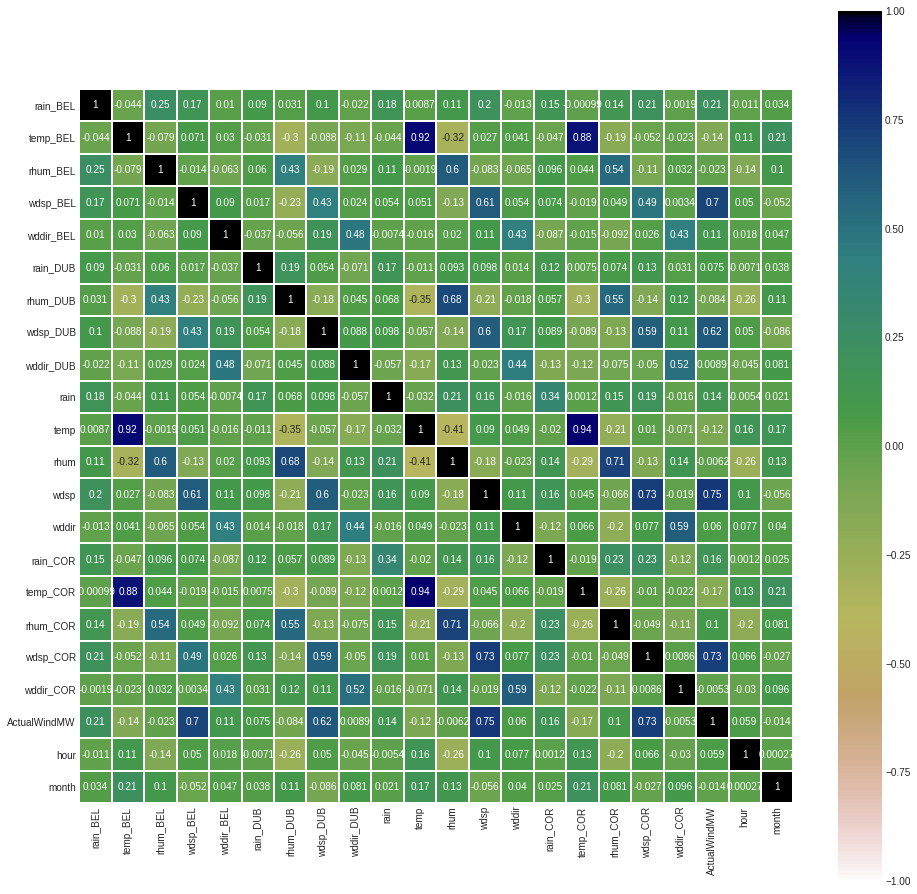

In [32]:
col_list_numerical = ['rain_BEL', 'temp_BEL', 
       'rhum_BEL', 'wdsp_BEL', 'wddir_BEL', 'rain_DUB',
       'rhum_DUB', 'wdsp_DUB',
       'wddir_DUB', 'rain', 'temp', 'rhum', 'wdsp',
       'wddir', 
       'rain_COR', 'temp_COR', 'rhum_COR',
       'wdsp_COR', 'wddir_COR',  
       'ActualWindMW', 'hour', 'isweekday', 'month']

df_corr = newdf[col_list_numerical].corr()

plt.figure(figsize=[16, 16])
sns.heatmap(data=df_corr, vmin=-1, vmax=1, cmap='gist_earth_r', annot=True, square=True, linewidths=1)
plt.xticks(rotation=90)
plt.yticks(rotation=0)

# Electricity Generation by fuel type

Data from https://www.seai.ie/data-and-insights/seai-statistics/monthly-energy-data/electricity/

In [33]:
#/content/drive/MyDrive/CA683Project/seai_Electricity_Monthly_Timeseries.csv
  
filename = 'seai_Electricity_Monthly_Timeseries.csv'
eGen = pd.read_csv(filename, header=0)

eGen

,Electricity Generation (GWh),Label,Notes,Jan-10,Feb-10,Mar-10,Apr-10,May-10,Jun-10,Jul-10,Aug-10,Sep-10,Oct-10,Nov-10,Dec-10,Jan-11,Feb-11,Mar-11,Apr-11,May-11,Jun-11,Jul-11,Aug-11,Sep-11,Oct-11,Nov-11,Dec-11,Jan-12,Feb-12,Mar-12,Apr-12,May-12,Jun-12,Jul-12,Aug-12,Sep-12,Oct-12,Nov-12,Dec-12,Jan-13,...,Sep-17,Oct-17,Nov-17,Dec-17,Jan-18,Feb-18,Mar-18,Apr-18,May-18,Jun-18,Jul-18,Aug-18,Sep-18,Oct-18,Nov-18,Dec-18,Jan-19,Feb-19,Mar-19,Apr-19,May-19,Jun-19,Jul-19,Aug-19,Sep-19,Oct-19,Nov-19,Dec-19,Jan-20,Feb-20,Mar-20,Apr-20,May-20,Jun-20,Jul-20,Aug-20,Sep-20,Oct-20,Nov-20,Dec-20
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Thermal Generation,A,:=B+C+D+E+F+G+H,2166.0,2043.9,2109.3,1851.5,1828.8,1815.7,1777.1,1763.8,1788.3,1851.1,1979.5,2299.8,2125.4,1714.3,1991.3,1647.5,1432.6,1613.0,1725.2,1783.6,1485.3,1693.5,1655.4,1722.0,2380.6,2156.2,2092.3,2005.0,2016.1,1807.0,1855.9,1858.8,1865.1,2089.6,2192.7,2201.6,1738.2,...,1717.4,1564.6,1786.9,1735.7,1468.4,1503.8,1768.8,1640.5,1843.7,1978.9,2030.0,1753.0,1546.4,1618.8,1487.9,1384.5,1687.2,1188.4,1413.3,1586.4,1801.8,1650.5,1667.3,1369.8,1402.5,1495.9,1700.4,1430.7,1463.2,1190.1,1386.7,1497.4,1543.9,1587.6,1648.6,1746.5,1638.1,1403.5,1478.5,1520.1
2,Coal,B,NaN,399.8,407.5,308.0,232.9,271.5,167.5,243.0,225.7,219.9,274.6,295.8,425.2,320.1,289.5,394.2,303.9,280.5,292.4,246.0,290.1,278.3,351.5,401.4,388.5,338.7,453.9,411.9,421.1,354.0,358.5,460.7,311.5,344.0,484.8,488.9,464.5,453.5,...,218.4,186.4,326.2,426.0,272.3,373.8,466.5,257.3,172.5,155.7,161.9,125.8,122.4,0.0,0.0,0.0,129.6,88.3,60.6,10.3,1.6,62.0,1.6,24.9,41.0,9.7,77.6,70.3,3.9,0.0,28.2,74.2,9.9,83.0,101.7,100.6,88.5,78.8,90.0,105.7
3,Peat,C,NaN,194.6,189.5,171.7,213.0,177.3,140.8,93.8,88.5,163.6,224.6,220.9,209.2,227.7,207.2,235.3,117.4,128.1,133.1,130.4,91.9,192.7,225.0,179.9,206.2,226.9,221.0,210.2,203.7,231.4,207.8,211.8,155.0,159.7,181.3,213.8,191.8,199.1,...,176.6,155.6,179.6,222.4,194.7,182.5,165.2,199.9,231.7,157.5,119.6,143.5,186.3,239.8,218.5,208.4,233.8,184.5,205.4,210.4,171.4,143.1,54.6,115.9,164.7,211.9,214.8,195.3,197.3,160.0,156.3,78.8,55.4,55.8,4.4,17.8,57.5,151.2,180.5,106.5
4,Oil,D,NaN,77.4,29.5,15.8,14.3,6.8,34.0,1.3,16.3,7.4,10.8,21.1,71.5,18.7,11.4,6.1,16.3,1.2,0.9,0.9,7.5,0.4,4.4,4.5,1.9,7.3,0.3,0.5,0.3,6.4,3.2,2.4,3.5,2.4,3.2,5.4,2.7,1.2,...,3.6,1.8,2.4,1.0,0.3,1.8,17.4,0.1,0.1,0.3,1.1,2.9,3.3,7.0,10.0,9.7,19.9,4.6,7.4,15.7,17.3,7.9,8.8,5.9,7.4,16.6,12.8,7.1,11.7,4.9,10.1,6.9,11.2,25.4,20.5,48.9,33.7,18.8,14.5,17.6
5,Natural Gas,E,NaN,1474.3,1395.2,1591.5,1367.8,1354.0,1456.3,1419.7,1412.8,1375.7,1319.0,1419.5,1573.0,1548.7,1193.0,1340.6,1197.1,1006.4,1172.0,1334.4,1381.3,998.2,1096.3,1058.5,1108.2,1266.4,1102.3,1149.8,1006.7,1156.5,989.1,952.0,1091.0,1038.6,1137.8,1115.4,1069.8,1054.4,...,1258.0,1161.4,1215.9,1024.4,938.0,894.2,1067.7,1124.8,1368.6,1600.5,1673.0,1438.7,1169.4,1300.2,1195.9,1098.5,1231.5,852.2,1088.3,1285.8,1544.9,1371.5,1541.4,1164.2,1135.9,1197.3,1312.5,1090.2,1172.2,948.2,1113.8,1260.8,1395.6,1363.9,1443.1,1500.3,1378.6,1091.5,1137.1,1232.8
6,Combustible Renewables,F,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,14.8,13.7,14.3,14.5,13.8,13.5,12.0,13.8,14.8,16.4,16.4,16.2,16.5,16.5,15.4,16.2,17.2,14.4,16.7,16.4,17.1,16.0,15.0,15.6,15.5,15.6,27.5,24.7,25.3,24.5,23.1,23.7,21.7,21.9,23.1,22.2,22.2,17.3,14.3,16.6
7,Wastes,G,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.1,6.2,10.8,10.8,9.3,8.3,8.2,4.4,9.9,10.8,8.7,10.1,10.7,...,46.1,45.7,48.4,47.5,49.3,37.9,40.1,44.6,56.0,48.5,58.1,26.0,48.4,55.4,48.2,51.6,55.1,44.4,34.9,47.7,49.5,50.0,46.0,43.2,38.0,44.

In [34]:
eGen = eGen.transpose()

In [35]:
eGen.index

Index(['Electricity Generation (GWh)', 'Label', 'Notes', 'Jan-10', 'Feb-10',
       'Mar-10', 'Apr-10', 'May-10', 'Jun-10', 'Jul-10',
       ...
       'Mar-20', 'Apr-20', 'May-20', 'Jun-20', 'Jul-20', 'Aug-20', 'Sep-20',
       'Oct-20', 'Nov-20', 'Dec-20'],
      dtype='object', length=135)

In [36]:
eGen = eGen.drop(columns=0)

In [37]:
eGen.columns = eGen.iloc[0]

In [38]:
eGen.columns

Index(['Thermal Generation', 'Coal', 'Peat', 'Oil', 'Natural Gas',
       'Combustible Renewables', 'Wastes', 'Other (CHP etc)',
       'Non-Combustible Renewable Generation', 'Hydro', 'Wind', 'Solar',
       'Indigenous Generation', 'Net imports', 'Imports', 'Exports',
       'Total Generation', 'Pumped Hydro Storage', 'Pumping', 'Generated',
       'Total Generated Less Pumped Hydro Storage Losses'],
      dtype='object', name='Electricity Generation (GWh)')

In [39]:
eGen = eGen.drop(index=['Electricity Generation (GWh)', 'Label', 'Notes'])

In [40]:
eGen["Date"] = pd.to_datetime(eGen.index, infer_datetime_format=True, errors='ignore')

In [41]:
eGen

Electricity Generation (GWh),Thermal Generation,Coal,Peat,Oil,Natural Gas,Combustible Renewables,Wastes,Other (CHP etc),Non-Combustible Renewable Generation,Hydro,Wind,Solar,Indigenous Generation,Net imports,Imports,Exports,Total Generation,Pumped Hydro Storage,Pumping,Generated,Total Generated Less Pumped Hydro Storage Losses,Date
Jan-10,2166,399.8,194.6,77.4,1474.3,0,0,19.9,345,97,248,0,2511,133.1,137.6,-4.4,2644.1,-19.9,-50.3,30.4,2624.2,Jan-10
Feb-10,2043.9,407.5,189.5,29.5,1395.2,0,0,22.2,210.7,59.8,151,0,2254.6,99.3,107.6,-8.3,2353.9,-17.7,-44.4,26.8,2336.2,Feb-10
Mar-10,2109.3,308,171.7,15.8,1591.5,0,0,22.2,280.3,28.9,251.4,0,2389.6,60.7,74,-13.3,2450.3,-18.4,-47.9,29.5,2431.9,Mar-10
Apr-10,1851.5,232.9,213,14.3,1367.8,0,0,23.4,260.1,73.8,186.3,0,2111.5,32.4,51.4,-18.9,2143.9,-17.9,-46.2,28.3,2126.1,Apr-10
May-10,1828.8,271.5,177.3,6.8,1354,0,0,19.1,181.4,12.9,168.5,0,2010.1,102.4,104.9,-2.5,2112.6,-17.5,-45.4,27.9,2095.1,May-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Aug-20,1746.5,100.6,17.8,48.9,1500.3,22.2,53.3,3.5,657.9,68.1,589.8,0,2404.4,-45.9,89.4,-135.3,2358.5,-22,-47.1,25.1,2336.5,Aug-20
Sep-20,1638.1,88.5,57.5,33.7,1378.6,22.2,54.3,3.5,813.3,57.7,755.6,0,2451.4,-44.7,139.8,-184.5,2406.7,-19.3,-43.5,24.3,2387.5,Sep-20
Oct-20,1403.5,78.8,151.2,18.8,1091.5,17.3,36.2,9.6,1255.5,85.1,1170.4,0,2659,9.2,177.4,-168.2,2668.2,-22.8,-46.2,23.4,2645.4,Oct-20
Nov-20,1478.5,90,180.5,14.5,1137.1,14.3,40.9,1.1,1196.1,136.2,1059.9,0,2674.6,-35.4,150.7,-186.1,2639.2,-12.6,-29,16.4,2626.6,Nov-20


In [42]:
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{"secondary_y": True}]],
    subplot_titles=("Electricity Generation by fuel type"))

fig.add_trace(go.Scatter(x=eGen['Date'], y=(eGen['Wind']),
                    mode='lines',
                    name='Wind',showlegend=True), 1, 1, secondary_y=False)

fig.add_trace(go.Scatter(x=eGen['Date'], y=(eGen['Total Generation']),
                    mode='lines',
                    name='Total Generation',showlegend=True), 1, 1, secondary_y=False)